## 1 数据预处理

In [1]:
import re
import os
import time
import csv
import math
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import myUtils

### 获取每个设备的数据文件夹

In [2]:
root_data_path = '../data/'
raw_data_path = root_data_path + '0_raw_data/'
machine_folders = os.listdir(raw_data_path)
print(machine_folders)

['1#ToExcel', '10#ToExcel', '2#ToExcel', '3#ToExcel', '4#ToExcel', '5#ToExcel', '6#ToExcel', '7#ToExcel', '8#ToExcel', '9#ToExcel']


In [3]:
# 获得设备编号
machine_ids = [re.match('(.*)#ToExcel', machine_folder).group(1) for machine_folder in machine_folders]
print(machine_ids)

['1', '10', '2', '3', '4', '5', '6', '7', '8', '9']


In [4]:
processed_data_path = root_data_path + '1_processed_data/'
myUtils.makedirs(processed_data_path)

In [3]:
list(range(-3, 0))

[-3, -2, -1]

### 1.1 手动剔除无效数据
根据波形手动剔除无效数据，并将无效数据的波形存入0_removed_data_fig

#### 1) 显示操作初期和操作末期的波形，保存于0_raw_data_fig中

1#ToExcel
2020年08月26日13时38分37.27秒 第1次.xlsx
2020年08月26日13时39分09.79秒 第1次.xlsx
2020年08月26日13时44分17.07秒 第1次.xlsx
2020年08月26日13时44分27.11秒 第2次.xlsx
2020年08月26日13时44分37.04秒 第3次.xlsx
2020年08月26日13时44分45.97秒 第4次.xlsx
2020年08月26日13时44分46.27秒 第5次.xlsx
2020年08月26日13时45分48.46秒 第1次.xlsx
2020年08月26日13时47分23.44秒 第1次.xlsx
2020年08月26日13时51分00.28秒 第2次.xlsx
2020年08月26日18时10分58.98秒 第1127次.xlsx
2020年08月26日18时11分09.02秒 第1128次.xlsx
2020年08月26日18时11分13.94秒 第1129次.xlsx
2020年08月26日18时11分14.14秒 第1130次.xlsx
2020年08月26日18时11分14.34秒 第1131次.xlsx
10#ToExcel
2020年08月28日16时01分41.30秒 第1次.xlsx
2020年08月28日16时02分01.36秒 第3次.xlsx
2020年08月28日16时02分11.39秒 第4次.xlsx
2020年08月28日16时02分21.42秒 第5次.xlsx
2020年08月28日16时02分31.36秒 第6次.xlsx
2020年08月28日16时02分41.38秒 第7次.xlsx


D:\Env\Anaconda3\lib\site-packages\ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


2020年08月28日16时02分51.42秒 第8次.xlsx
2020年08月28日16时03分01.46秒 第9次.xlsx
2020年08月28日16时03分11.50秒 第10次.xlsx
2020年08月28日16时03分21.53秒 第11次.xlsx
2020年08月29日14时35分41.01秒 第1650次.xlsx
2020年08月29日14时35分41.11秒 第1651次.xlsx
2020年08月29日14时35分41.21秒 第1652次.xlsx
2020年08月29日14时35分41.31秒 第1653次.xlsx
2020年08月29日14时35分41.41秒 第1654次.xlsx
2#ToExcel
2020年08月26日13时44分20.38秒 第1次.xlsx
2020年08月26日13时44分30.42秒 第2次.xlsx
2020年08月26日13时44分40.45秒 第3次.xlsx
2020年08月26日13时44分46.07秒 第4次.xlsx
2020年08月26日13时44分46.37秒 第5次.xlsx
2020年08月26日13时47分23.54秒 第1次.xlsx
2020年08月26日13时51分03.69秒 第2次.xlsx
2020年08月26日13时51分13.63秒 第3次.xlsx
2020年08月26日13时51分23.66秒 第4次.xlsx
2020年08月26日13时51分33.70秒 第5次.xlsx
2020年08月27日13时26分55.74秒 第1749次.xlsx
2020年08月27日13时27分05.78秒 第1750次.xlsx
2020年08月27日13时27分15.82秒 第1751次.xlsx
2020年08月27日13时27分29.16秒 第1752次.xlsx
2020年08月27日13时27分44.11秒 第1753次.xlsx
3#ToExcel
2020年08月26日13时44分23.80秒 第1次.xlsx
2020年08月26日13时44分33.73秒 第2次.xlsx
2020年08月26日13时44分43.77秒 第3次.xlsx
2020年08月26日13时44分46.17秒 第4次.xlsx
2020年08月26日13时47分23.64秒 

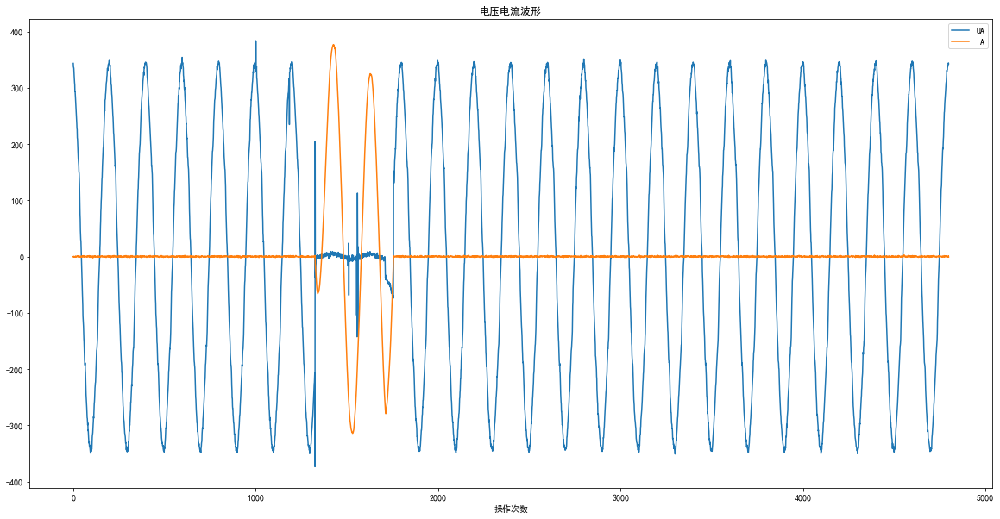

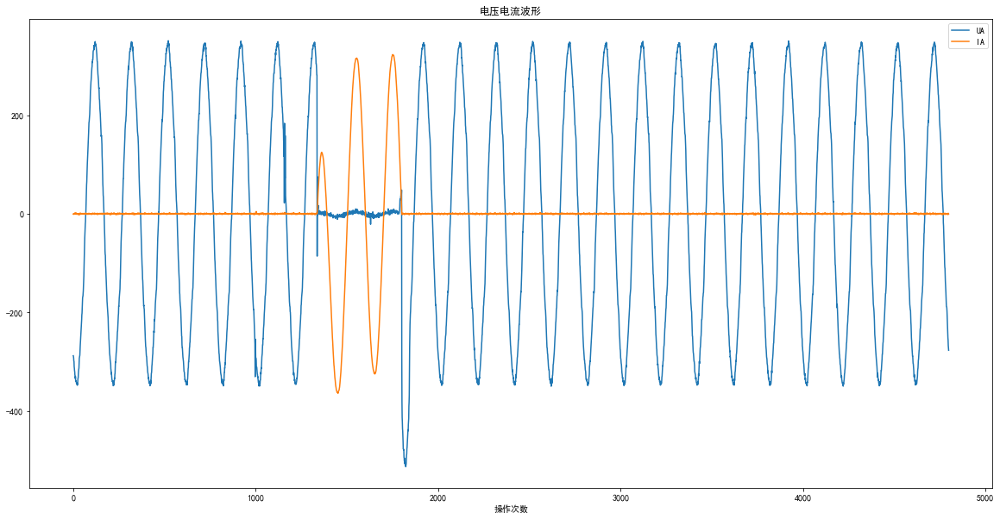

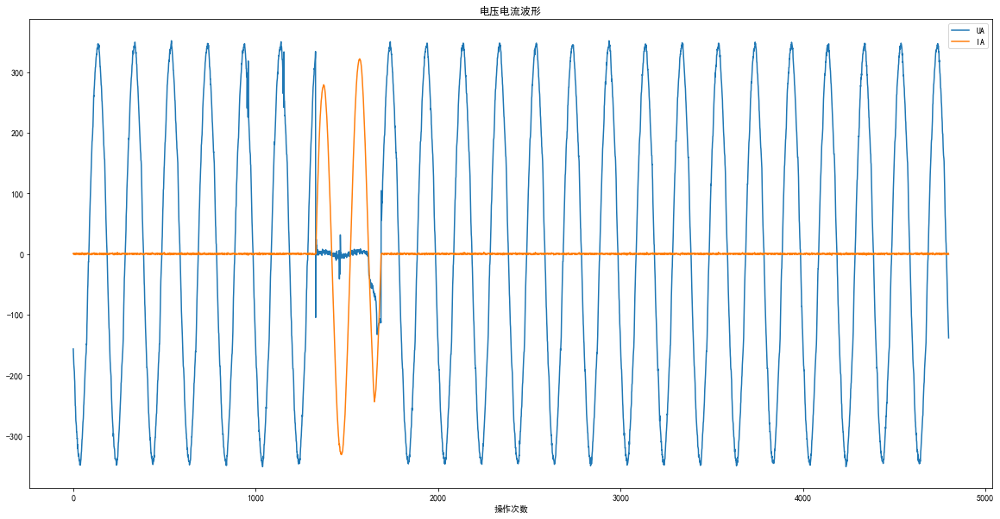

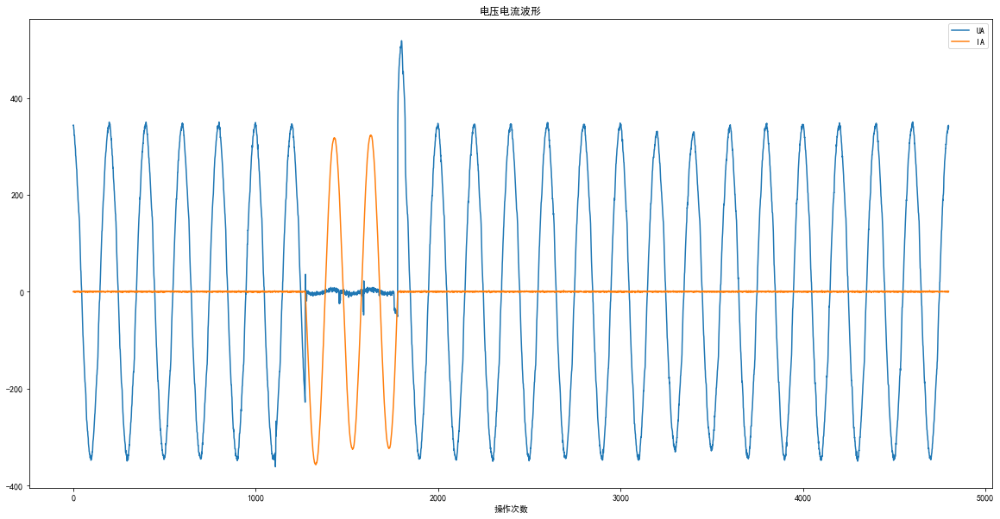

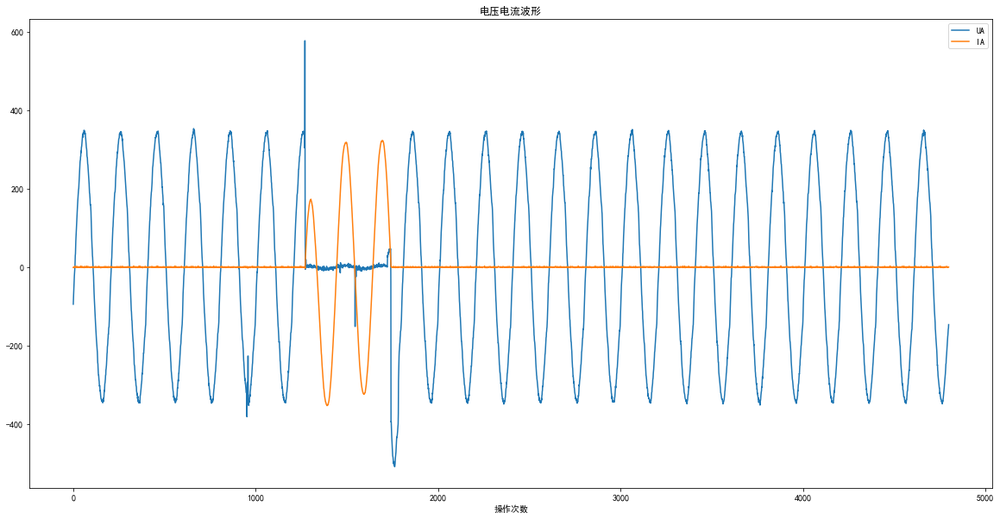

...

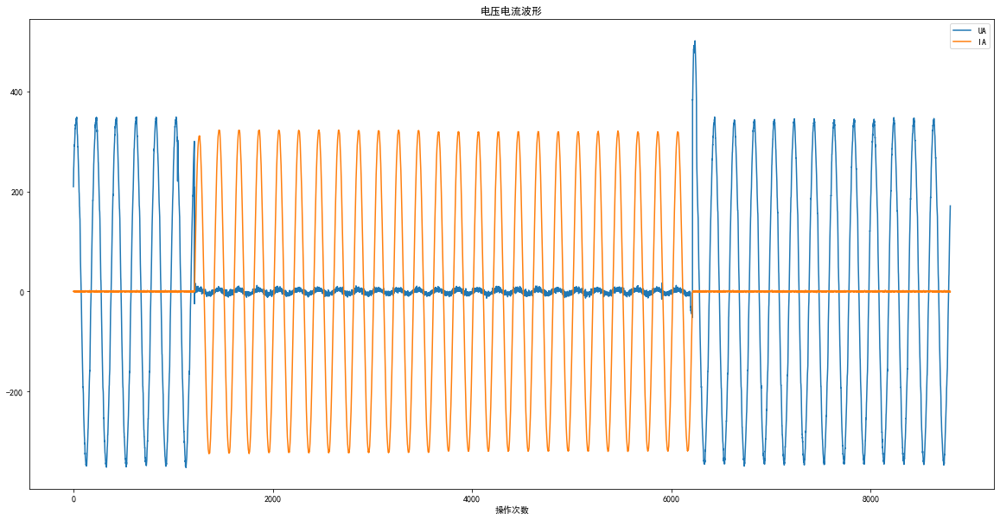

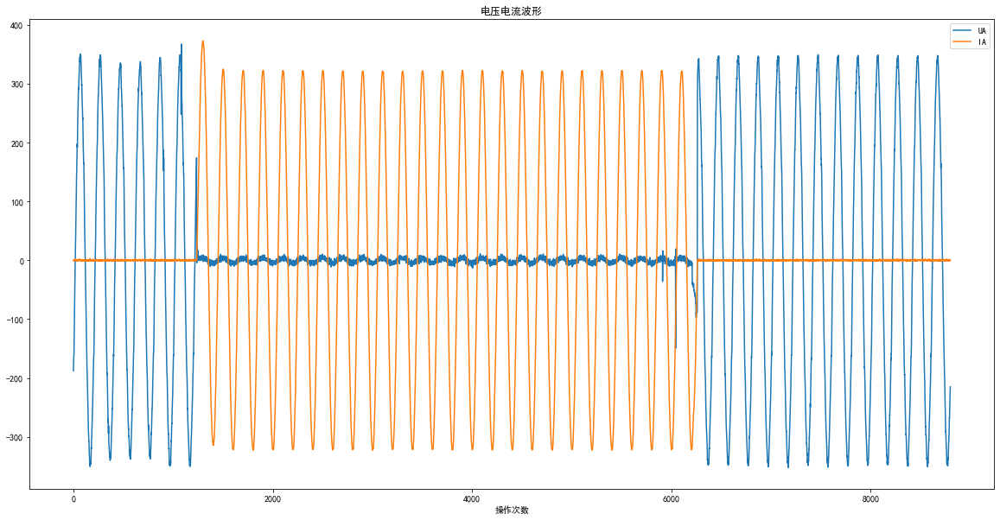

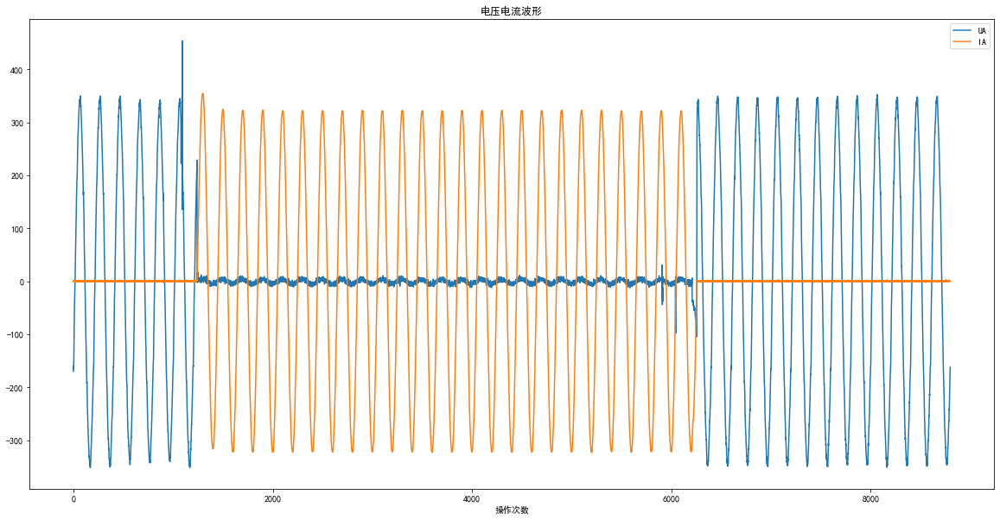

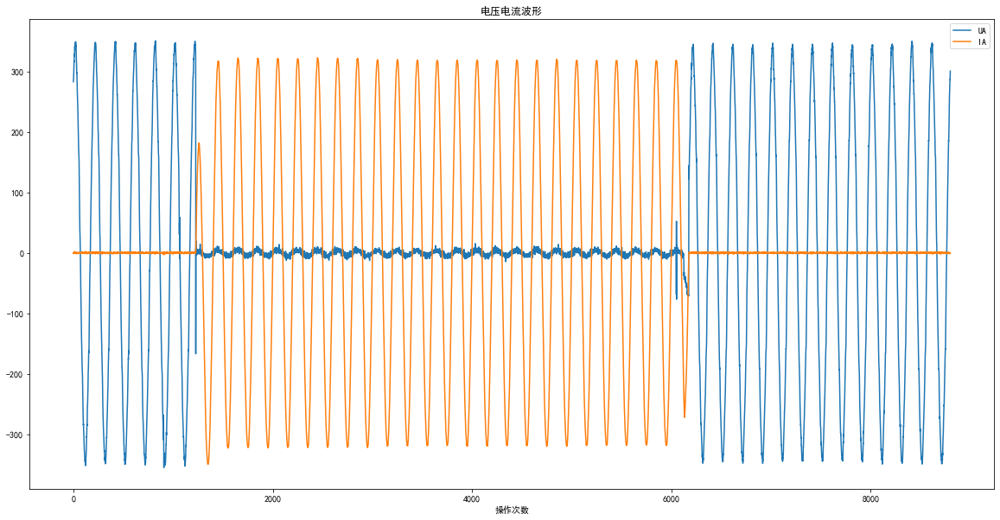

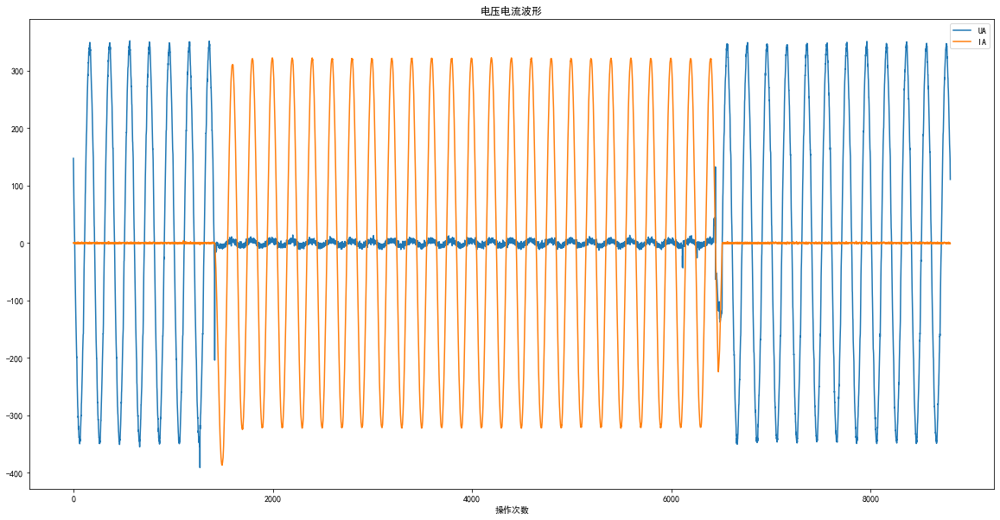

In [5]:
# 显示操作初期和操作末期的波形
removed_data_fig_path = processed_data_path + '0_raw_data_fig/'
for machine_idx in range(10):
    machine_file_path = raw_data_path + machine_folders[machine_idx] + '/'
    print(machine_folders[machine_idx])
    machine_files = os.listdir(machine_file_path)

    file_ids = list(range(10)) + list(range(-5, 0))
    for file_id in file_ids:
        print(machine_files[file_id])
        operation_data = pd.read_excel(machine_file_path+ machine_files[file_id])

        #解决中文显示问题
        plt.rcParams['font.sans-serif']=['SimHei']
        plt.rcParams['axes.unicode_minus'] = False #坐标轴有负号时可以显示负号
        plt.figure(figsize=(20,10))
        plt.plot(operation_data['UA'])
        plt.plot(operation_data['IA'])
        plt.title('电压电流波形')
        plt.xlabel('操作次数')
        plt.legend(['UA', 'IA'])

        removed_data_fig_folder = removed_data_fig_path + machine_folders[machine_idx] + '/'
        myUtils.makedirs(removed_data_fig_folder)
        plt.savefig(removed_data_fig_folder + re.match('(.*).xlsx', machine_files[file_id]).group(1) + '.png',dpi=100,bbox_inches ='tight')

#### 2) 根据波形手动筛选出无效数据对应的波形图，保存于0_raw_data_fig_removed中

#### 3) 删除无效数据，保存于0_raw_data_removed中

In [25]:
import shutil
# 1.将所有原始数据拷贝到新文件夹中
copied_data_path = processed_data_path + '0_raw_data_removed/'
if not os.path.exists(copied_data_path): 
    shutil.copytree(raw_data_path, copied_data_path)

# 2.删除新文件中的无效数据
removed_data_fig_path = processed_data_path + '0_raw_data_fig_removed/'
machine_folders = os.listdir(removed_data_fig_path)

for machine_idx in range(len(machine_folders)):
    removed_files = os.listdir(removed_data_fig_path + machine_folders[machine_idx] + '/')
    
    removed_data_path = copied_data_path + machine_folders[machine_idx] +'/'
    # 判断是否有需要删除的文件
    if removed_files:
        for tmp_file in removed_files:
            tmp_file_name = re.match('(.*).png', tmp_file).group(1) + '.xlsx'
            #print(tmp_file_name)
            tmp_file_path = removed_data_path + tmp_file_name
            if os.path.exists(tmp_file_path):  # 如果文件存在
                # 删除文件，可使用以下两种方法。
                os.remove(tmp_file_path)  
                print('删除文件%s'%tmp_file_path)
            else:
                print('文件' + tmp_file_path + ' 不存在/已删除')
    print('设备'+ re.match('(.*).ToExcel', machine_folders[machine_idx]).group(1) +'的总操作次数为：' + str(len(os.listdir(removed_data_path))))

设备1的总操作次数为：1130
设备10的总操作次数为：1650
设备2的总操作次数为：1751
设备3的总操作次数为：504
设备4的总操作次数为：186
设备5的总操作次数为：2971
设备6的总操作次数为：2159
设备7的总操作次数为：4522
设备8的总操作次数为：1622
设备9的总操作次数为：1393


### 1.1 剔除无效操作数据 

In [ ]:
def eliminateInvalidOperationData(machine_folder_path):
    '''
    Eliminate invalid operation data in a single machine
    处理单个设备数据： 根据文件大小粗略略剔除无效的操作数据
    
    Args:
        machine_folder_path: 单个设备历次操作数据所在的文件夹路径
    
    Returns:
        operation_data_list: 剔除无效操作得到的操作数据列表
    
    '''
    # load machine operation files
    #machine_data_path = raw_data_path + machine_id +'#ToExcel/'
    machine_files = os.listdir(machine_folder_path)
    machine_files.sort()
    
    print('====Elimination start====')
    # get operation data
    operation_data_list = []
    for i, machine_file in enumerate(machine_files):
        tmp_file_path = machine_folder_path + machine_file
        
        if i % 100 == 0:
            print(i)
            
        ## 根据文件大小判断采集的数据是否为有效数据
        # 获取文件大小(KB)
        tmp_file_size = os.path.getsize(tmp_file_path) / float(1024)
        # 若文件大小小于阈值则为无效数据
        if tmp_file_size > 800:
            tmp_data = pd.read_excel(tmp_file_path)
            operation_data_list += [tmp_data]
        else:
            print('Eliminate file:',tmp_file_path, tmp_file_size)
    print('====Elimination completed====')
    return operation_data_list

遍历剔除每个设备的无效数据，并将处理后的数据存入1_processed_data文件夹

#### 4) 将原始操作数据转化为pickle文件

In [33]:
def rawOperationFiles2pickle(machine_folder_path, pickle_file_path):
    machine_files = os.listdir(machine_folder_path)
    machine_files.sort()
    
    # 读取操作数据
    operation_data_list = []
    for i, machine_file in enumerate(machine_files):
        tmp_file_path = machine_folder_path + machine_file
        tmp_data = pd.read_excel(tmp_file_path)
        operation_data_list += [tmp_data]
        if i % 100 == 0:
            print(i)
        
    # 转为pickle文件
    pkl_file = open(pickle_file_path, 'wb')
    pickle.dump(operation_data_list, pkl_file)
    pkl_file.close()
    
    print(pkl_file, len(operation_data_list))

In [34]:
copied_data_dir = processed_data_path + '0_raw_data_removed/'
pickle_data_dir = processed_data_path + '1_pickle_data/'
myUtils.makedirs(pickle_data_dir)
for machine_id in machine_ids:
    machine_folder_path = copied_data_dir + machine_id + '#ToExcel/'
    pickle_file_path = pickle_data_dir + machine_id +'.pkl'
    print('原文件夹路径：' + machine_folder_path, '新文件路径：', pickle_file_path)
    rawOperationFiles2pickle(machine_folder_path, pickle_file_path)
    print(machine_id + ' completed')

原文件夹路径：../data/1_processed_data/0_raw_data_removed/1#ToExcel/ 新文件路径： ../data/1_processed_data/1_pickle_data/1.pkl
0
100
200
300
400
500
600
700
800
900
1000
1100
<_io.BufferedWriter name='../data/1_processed_data/1_pickle_data/1.pkl'> 1130
1 completed
原文件夹路径：../data/1_processed_data/0_raw_data_removed/10#ToExcel/ 新文件路径： ../data/1_processed_data/1_pickle_data/10.pkl
0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
<_io.BufferedWriter name='../data/1_processed_data/1_pickle_data/10.pkl'> 1650
10 completed
原文件夹路径：../data/1_processed_data/0_raw_data_removed/2#ToExcel/ 新文件路径： ../data/1_processed_data/1_pickle_data/2.pkl
0
100
200
300
400
500
600
700
800
900
1000
1100
1200
1300
1400
1500
1600
1700
<_io.BufferedWriter name='../data/1_processed_data/1_pickle_data/2.pkl'> 1751
2 completed
原文件夹路径：../data/1_processed_data/0_raw_data_removed/3#ToExcel/ 新文件路径： ../data/1_processed_data/1_pickle_data/3.pkl
0
100
200
300
400
500
<_io.BufferedWriter name='../data/1_processed_dat

### 1.2 数据降噪

In [35]:
def movingAverage(sequence, window_size):
    """ 滑动平均：对序列进行平滑处理 """
    window = np.ones(int(window_size)) / float(window_size)
    return np.convolve(sequence, window, 'same')

def singleOperationSmooth(df, smooth_win_size = 5, columns = []):
    """
    对设备的单次操作数据平滑
    
    Args:
        df: 原始数据dataframe
        smooth_win_size: 滑动窗口大小（默认为5）
        columns: 需要平滑的数据列名（默认为[]，即平滑所有列）
    
    Returns:
        df_smooth: 平滑后的数据
    """
    df_smooth = pd.DataFrame()
    if not columns:
        columns = df.columns
    for col in columns:
        df_smooth[col] = movingAverage(df[col], smooth_win_size)
    return df_smooth

In [36]:
def totalOperationSmooth(operation_data, smooth_win_size):
    """
    对设备的所有操作数据平滑
    """
    operation_data_smooth = []
    for data in operation_data:
        operation_data_smooth += [singleOperationSmooth(data, smooth_win_size)]
    return operation_data_smooth

遍历每个设备的操作数据，进行平滑处理后存入1_smoothed_data

In [37]:
smoothed_data_path = processed_data_path + '2_smoothed_data/'
myUtils.makedirs(smoothed_data_path)
smooth_win_size = 5

remained_data_path = processed_data_path + '1_pickle_data/'
remained_machine_files = os.listdir(remained_data_path)
for tmp_file in remained_machine_files:#[processed_machine_files[0]]:
    pkl_file = open(remained_data_path + tmp_file, 'rb')
    #print(pkl_file)
    operation_data_list = pickle.load(pkl_file)
    pkl_file.close()
    
    operation_data_smooth_list = []
    for data in operation_data_list:
        operation_data_smooth_list += [singleOperationSmooth(data, smooth_win_size)]

    output = open(smoothed_data_path + tmp_file, 'wb')
    pickle.dump(operation_data_smooth_list, output)
    output.close()
    print(tmp_file, len(operation_data_smooth_list))

1.pkl 1130
10.pkl 1650
2.pkl 1751
3.pkl 504
4.pkl 186
5.pkl 2971
6.pkl 2159
7.pkl 4522
8.pkl 1622
9.pkl 1393


<Figure size 720x576 with 0 Axes>

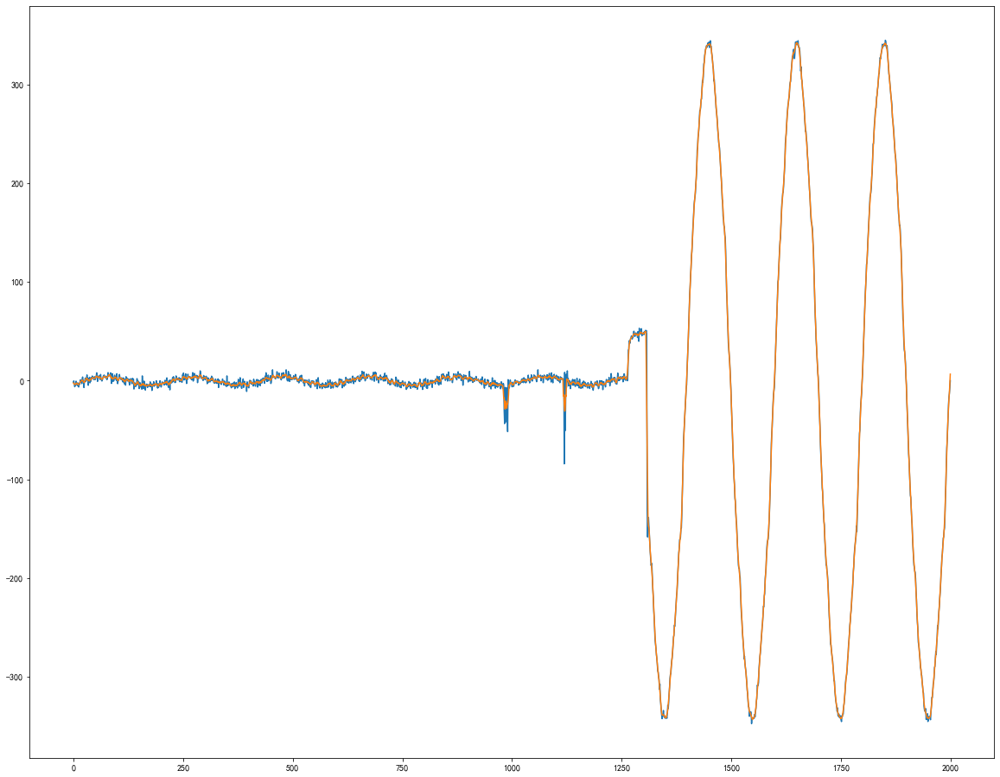

In [38]:
# unit test
i = 2
plt.figure(figsize=(10,8))
U_data = operation_data_list[i]['UA']
I_data = operation_data_list[i]['IA']
smooth_win_size = 5
U_data_smooth = movingAverage(U_data, smooth_win_size)
plt.figure(figsize=(20,16))
data_range = np.arange(5000,7000)
plt.plot(np.array(U_data[data_range]))
plt.plot(U_data_smooth[data_range])

In [39]:
smoothed_machine_files =os.listdir(smoothed_data_path)
print(smoothed_machine_files)
for tmp_file in [smoothed_machine_files[0]]:
    pkl_file = open(smoothed_data_path + tmp_file, 'rb')
    #print(pkl_file)
    operation_data = pickle.load(pkl_file)
    pkl_file.close()
    print(tmp_file, len(operation_data))

['1.pkl', '10.pkl', '2.pkl', '3.pkl', '4.pkl', '5.pkl', '6.pkl', '7.pkl', '8.pkl', '9.pkl']
1.pkl 1130
